# NBA Stats Analysis

### NBA Player Stats through 2017 via BasketballReference.com

* https://www.kaggle.com/drgilermo/nba-players-stats?select=player_data.csv

### Imports

In [220]:
import pandas as pd
import matplotlib.pyplot as plt
import numpy as np
import altair as alt
from sklearn.manifold import TSNE
from sklearn.cluster import KMeans

### Data

In [91]:
player_data = pd.read_csv("player_data.csv")
players = pd.read_csv("Players.csv")
stats = pd.read_csv("Seasons_Stats.csv")

In [94]:
player_data["career_length"] = player_data.year_end - player_data.year_start
print(player_data.shape)
player_data.head()

(4550, 9)


,name,year_start,year_end,position,height,weight,birth_date,college,career_length
0,Alaa Abdelnaby,1991,1995,F-C,6-10,240.0,"June 24, 1968",Duke University,4
1,Zaid Abdul-Aziz,1969,1978,C-F,6-9,235.0,"April 7, 1946",Iowa State University,9
2,Kareem Abdul-Jabbar,1970,1989,C,7-2,225.0,"April 16, 1947","University of California, Los Angeles",19
3,Mahmoud Abdul-Rauf,1991,2001,G,6-1,162.0,"March 9, 1969",Louisiana State University,10
4,Tariq Abdul-Wahad,1998,2003,F,6-6,223.0,"November 3, 1974",San Jose State University,5


print(players.shape)
players.head()
#won't likely use this one. Doesn;t improve on above

In [96]:
print(stats.shape)
stats[stats.Player == "Cody Zeller"]

(24691, 53)


,Unnamed: 0,Year,Player,Pos,Age,Tm,G,GS,MP,PER,...,FT%,ORB,DRB,TRB,AST,STL,BLK,TOV,PF,PTS
22862,22862,2014.0,Cody Zeller,C,21.0,CHA,82.0,3.0,1416.0,13.1,...,0.730,118.0,235.0,353.0,92.0,40.0,41.0,87.0,170.0,490.0
23514,23514,2015.0,Cody Zeller,C,22.0,CHO,62.0,45.0,1487.0,14.1,...,0.774,97.0,265.0,362.0,100.0,34.0,49.0,62.0,156.0,472.0
24093,24093,2016.0,Cody Zeller,C,23.0,CHO,73.0,60.0,1774.0,16.1,...,0.754,138.0,317.0,455.0,71.0,57.0,63.0,68.0,204.0,638.0
24686,24686,2017.0,Cody Zeller,PF,24.0,CHO,62.0,58.0,1725.0,16.7,...,0.679,135.0,270.0,405.0,99.0,62.0,58.0,65.0,189.0,639.0


### EDA

In [149]:
top_scorers = pd.DataFrame(stats.groupby("Player").mean())
top_scorers["PPG"] = top_scorers.PTS/top_scorers.G
top_scorers = round(top_scorers, 3)
top_scorers.sort_values(by = "PPG", ascending = False).head(5)

,Unnamed: 0,Year,Age,G,GS,MP,PER,TS%,3PAr,FTr,...,ORB,DRB,TRB,AST,STL,BLK,TOV,PF,PTS,PPG
Player,,,,,,,,,,,,,,,,,,,,,
Wilt Chamberlain*,2351.000,1966.312,29.312,69.875,NaN,3197.500,26.294,0.556,NaN,0.552,...,NaN,NaN,1599.812,305.812,NaN,NaN,NaN,138.812,2122.062,30.369
Michael Jordan*,11166.200,1992.800,28.800,71.467,69.267,2734.067,27.373,0.559,0.071,0.354,...,111.200,333.600,444.800,375.533,167.600,59.533,194.933,185.533,2152.800,30.123
Elgin Baylor*,2211.500,1965.500,30.500,60.429,NaN,2418.786,20.993,0.491,NaN,0.356,...,NaN,NaN,818.786,260.714,NaN,NaN,NaN,185.429,1653.500,27.363
Kevin Durant,21561.700,2012.500,23.500,70.300,70.300,2627.800,25.410,0.610,0.258,0.414,...,55.300,447.800,503.100,266.300,84.000,73.800,222.100,133.000,1912.100,27.199
LeBron James,20520.786,2010.500,25.500,75.786,75.714,2948.000,27.700,0.586,0.206,0.419,...,92.071,458.429,550.500,532.929,124.929,58.357,258.500,141.214,2056.214,27.132


([0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 19],
 <a list of 20 Text xticklabel objects>)

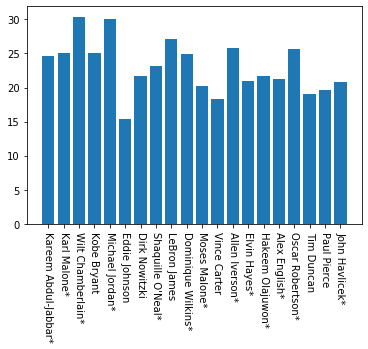

In [50]:
plt.bar(top_scorers.head(20).index, top_scorers.head(20).PTS/top_scorers.head(20).G)
plt.xticks(rotation = 270)

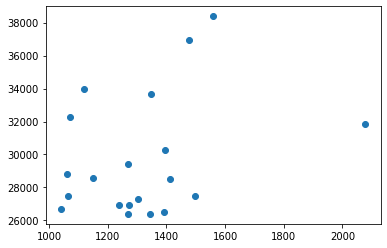

In [51]:
plt.scatter(top_scorers.head(20).G, top_scorers.head(20).PTS)

In [52]:
alt.data_transformers.disable_max_rows()

DataTransformerRegistry.enable('default')

In [81]:
top_scorers["name"] = top_scorers.index
top_scorers

,Unnamed: 0,Year,Age,G,GS,MP,PER,TS%,3PAr,FTr,...,DRB,TRB,AST,STL,BLK,TOV,PF,PTS,Player,name
Player,,,,,,,,,,,,,,,,,,,,,
Kareem Abdul-Jabbar*,114074,39590.0,630.0,1560.0,625.0,57446.0,481.7,11.830,0.018,6.502,...,9394.0,17440.0,5660.0,1160.0,3189.0,2527.0,4657.0,38387.0,Kareem Abdul-Jabbar*,Kareem Abdul-Jabbar*
Karl Malone*,232974,37905.0,589.0,1476.0,1471.0,54852.0,449.2,10.897,0.207,9.605,...,11406.0,14968.0,5248.0,2085.0,1145.0,4524.0,4578.0,36928.0,Karl Malone*,Karl Malone*
Wilt Chamberlain*,37616,31461.0,469.0,1118.0,0.0,51160.0,420.7,8.899,0.000,8.825,...,0.0,25597.0,4893.0,0.0,0.0,0.0,2221.0,33953.0,Wilt Chamberlain*,Wilt Chamberlain*
Kobe Bryant,362075,40130.0,550.0,1346.0,1198.0,48637.0,431.0,10.864,4.357,7.564,...,5548.0,7047.0,6306.0,1944.0,640.0,4010.0,3353.0,33643.0,Kobe Bryant,Kobe Bryant
Michael Jordan*,167493,29892.0,432.0,1072.0,1039.0,41011.0,410.6,8.392,1.064,5.310,...,5004.0,6672.0,5633.0,2514.0,893.0,2924.0,2783.0,32292.0,Michael Jordan*,Michael Jordan*
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
Gani Lawal,20861,2011.0,22.0,1.0,0.0,2.0,-9.1,0.000,0.000,0.000,...,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,Gani Lawal,Gani Lawal
Maurice Baker,51315,6015.0,75.0,10.0,0.0,38.0,-0.4,0.000,0.000,0.000,...,2.0,4.0,2.0,2.0,0.0,2.0,6.0,0.0,Maurice Baker,Maurice Baker
Al Jackson,2559,1968.0,24.0,2.0,0.0,17.0,-9.2,0.000,0.000,0.000,...,0.0,0.0,1.0,0.0,0.0,0.0,6.0,0.0,Al Jackson,Al Jackson


In [82]:
defense = alt.Chart(top_scorers).mark_circle(opacity = 0.5).encode(
    x = "STL",
    y = "BLK",
    color = "G",
    tooltip=['name', 'STL', 'BLK']
).interactive()

text = defense.mark_text(
    align='right',
    baseline='middle',
    dx=7
).encode(
    text='Player'
) # text not working

defense 

alt.Chart(...)

In [113]:
alt.Chart(stats).mark_circle().encode(
    x = "Age",
    y = "PER",
    tooltip=['Player', 'STL', 'BLK']
).interactive()

alt.Chart(...)

### The question on everybody's mind...

In [180]:
stats_40 = stats[stats.G>40]
stats_40_mj = stats_40[stats_40.Player == "Michael Jordan*"]
stats_40_lbj = stats_40[stats_40.Player == "LeBron James"]

stats_40_mj_bron = stats_40_mj.append(stats_40_lbj)
round(stats_40_mj_bron.groupby("Player").mean(),2)

,Unnamed: 0,Year,Age,G,GS,MP,PER,TS%,3PAr,FTr,...,FT%,ORB,DRB,TRB,AST,STL,BLK,TOV,PF,PTS
Player,,,,,,,,,,,,,,,,,,,,,
LeBron James,20520.79,2010.50,25.50,75.79,75.71,2948.00,27.70,0.59,0.21,0.42,...,0.74,92.07,458.43,550.50,532.93,124.93,58.36,258.50,141.21,2056.21
Michael Jordan*,11334.69,1993.15,29.15,79.77,78.08,3068.62,27.77,0.57,0.07,0.35,...,0.83,124.62,374.69,499.31,422.31,188.23,66.08,218.77,206.92,2417.46


In [189]:
points = alt.Chart(stats_40).mark_circle().encode(
    x = alt.X("Year:Q", scale=alt.Scale(zero=False)),
    y = "PER",
    tooltip=['Player',"Year","PER",'STL', 'BLK']).properties(
    width=800,
    height=400)

bars_mj_bron = alt.Chart(stats_40_mj_bron).mark_bar(
    cornerRadiusTopLeft=3,
    cornerRadiusTopRight=3).encode(
    x = alt.X("Year:Q", scale=alt.Scale(zero=False)),
    y = "PER",
    color = "Player:N",
    tooltip=['Player',"Year","PER",'STL', 'BLK']).properties(
    width=800,
    height=400)

#line isn't as visually intuitive as I'd hoped
line = alt.Chart(stats_40).mark_line().encode(
    x=alt.X("Year:Q", scale=alt.Scale(zero=False)),
    y="PER",
    tooltip=['Player',"Year","PER",'STL', 'BLK']).properties(
    width=800,
    height=400)

band = alt.Chart(stats_40).mark_errorband(extent='ci').encode(
    x=alt.X("Year:Q", scale=alt.Scale(zero=False)),
    y="PER",
)

link = alt.Chart(stats_40).transform_calculate(
    url='https://www.google.com/search?q=' + alt.datum.Player
    ).mark_point().encode(
    x=alt.X("Year:Q", scale=alt.Scale(zero=False)),
    y="PER",
    href='url:N',
    tooltip=['Player:N', 'url:N']
)

bars_mj_bron
#shift click link to open in new window

alt.Chart(...)

In [198]:
points + band + link

alt.LayerChart(...)

In [196]:
print(sum(stats_40_mj_bron.PER > 30))
print(sum(stats_40.PER > 30))

8
20


Lebron vs Jordan is definitely the low hanging fruit of NBA analysis. Looking at PER, which is a holisitic measure of overall performance, we see that they are both way above the league average of ~15. In history (thru 2017) there have only been 20 season by players who had a PER greater than 30, and Jordan and Lebron account for 8 of them.

### Best Season Ever?

In [211]:
#first gonna narrow down to seasons where the player played at least 41 games and had a PER of over 28.
#This leaves us with the 56 "best" full seasons in NBA history (thru 2017)
stats_best = stats_40[stats_40.PER>28]
#stats_best

In [218]:
points = alt.Chart(stats_best).mark_circle(size = 140).encode(
    x = alt.X("Year:Q", scale=alt.Scale(zero=False)),
    y = alt.Y("PER:Q", scale=alt.Scale(zero=False)),
    color = "Player:N",
    tooltip=['Player',"Year","G","PER","PTS", "TRB", "AST",'STL', 'BLK',"TOV"]).properties(
    width=800,
    height=400)

points

alt.Chart(...)

The chart above shows some of the best players ever, for sure, but it also omits some (no sign of Bill Russell, Larry Bird, Dr. J, Magic Johnson). This is because I used one stat and imposed a fairly arbitrary cutoff of 28. Still, it gives some idea of who the NBA's most statistically prolific players are.

### Clustering

Here I'll look at each player rather than each season by each player.

In [274]:
stats_grouped = stats.groupby("Player").sum()
stats_grouped_num = stats_grouped[['G', 'GS', 'MP',
       'OWS', 'DWS', 'WS', 'OBPM', 'DBPM', 'BPM',
       'VORP', 'FG', 'FGA', '3P', '3PA', '2P', '2PA',
       'FT', 'FTA', 'ORB', 'DRB', 'TRB', 'AST', 'STL', 'BLK',
       'TOV', 'PF', 'PTS']]
stats_grouped_num

,G,GS,MP,OWS,DWS,WS,OBPM,DBPM,BPM,VORP,...,FTA,ORB,DRB,TRB,AST,STL,BLK,TOV,PF,PTS
Player,,,,,,,,,,,,,,,,,,,,,
A.C. Green,1361.0,905.0,39044.0,60.7,43.5,104.2,-9.1,7.6,-1.5,23.0,...,4447.0,3576.0,6553.0,10129.0,1469.0,1103.0,562.0,1508.0,2581.0,12928.0
A.J. Bramlett,8.0,0.0,61.0,-0.2,0.1,-0.2,-10.5,-6.3,-16.8,-0.2,...,0.0,12.0,10.0,22.0,0.0,1.0,0.0,3.0,13.0,8.0
A.J. English,151.0,18.0,3108.0,-0.4,1.4,1.1,-4.5,-5.7,-10.2,-2.4,...,333.0,140.0,175.0,315.0,320.0,57.0,24.0,203.0,287.0,1502.0
A.J. Guyton,80.0,14.0,1246.0,0.3,-0.1,0.3,-18.2,-14.8,-33.0,-1.0,...,45.0,22.0,58.0,80.0,147.0,20.0,12.0,62.0,58.0,442.0
A.J. Hammons,22.0,0.0,163.0,-0.2,0.2,0.0,-7.5,1.9,-5.6,-0.1,...,20.0,8.0,28.0,36.0,4.0,1.0,13.0,10.0,21.0,48.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
Zelmo Beaty*,570.0,0.0,18348.0,36.9,21.3,58.1,-2.7,0.4,-2.3,-0.1,...,3087.0,93.0,234.0,5949.0,839.0,45.0,29.0,0.0,2132.0,9107.0
Zendon Hamilton,146.0,15.0,1609.0,1.4,1.5,3.2,-48.1,-23.3,-71.6,-1.3,...,371.0,187.0,288.0,475.0,33.0,43.0,28.0,114.0,220.0,611.0
Zoran Dragic,32.0,2.0,150.0,-0.2,0.0,-0.1,-5.8,-14.3,-20.1,-0.2,...,10.0,10.0,6.0,16.0,10.0,4.0,0.0,10.0,12.0,56.0


In [275]:
stats_grouped_num.shape
stats_grouped_num.index = range(stats_grouped_num.shape[0])

In [276]:
#stats_numerical = stats_grouped.select_dtypes(include = [np.number]).fillna(0).values
#stats_numerical



In [296]:
clustering = KMeans(n_clusters = 7).fit(stats_grouped_num)
len(clustering.labels_) #clustered data into one of three groups
stats_embedding = TSNE(n_components = 2).fit_transform(stats_grouped_num)

In [297]:
df = pd.DataFrame(stats_embedding)
df["cluster"] = clustering.labels_
df["Player"] = stats_grouped.index

df.columns = ["x", "y", "c","Player"]
df

,x,y,c,Player
0,28.227541,46.224491,6,A.C. Green
1,-52.092243,28.757683,4,A.J. Bramlett
2,-17.175158,-40.056885,0,A.J. English
3,20.020241,-66.277466,4,A.J. Guyton
4,-25.065424,49.541489,4,A.J. Hammons
...,...,...,...,...
3916,49.418503,23.792830,5,Zelmo Beaty*
3917,-4.460806,-66.720375,4,Zendon Hamilton
3918,-29.447844,51.543678,4,Zoran Dragic
3919,-0.570115,-73.230774,4,Zoran Planinic


In [342]:
alt.Chart(df, title = "NBA Player Clustering - Career Totals").mark_circle().encode(
    x = "x",
    y = "y",
    color = "c:N",
    tooltip = ["Player"]
)

alt.Chart(...)

In [303]:
c2 = list(df[df.c == 2].Player)

In [306]:
stats_w_cluster = stats.merge(df, on = "Player")
stats_w_cluster

,Unnamed: 0,Year,Player,Pos,Age,Tm,G,GS,MP,PER,...,AST,STL,BLK,TOV,PF,PTS,Cluster,x,y,c
0,0,1950.0,Curly Armstrong,G-F,31.0,FTW,63.0,NaN,NaN,NaN,...,176.0,NaN,NaN,NaN,217.0,458.0,6.0,-46.143291,-31.858625,4
1,314,1951.0,Curly Armstrong,G-F,32.0,FTW,38.0,NaN,NaN,NaN,...,77.0,NaN,NaN,NaN,97.0,202.0,4.0,-46.143291,-31.858625,4
2,1,1950.0,Cliff Barker,SG,29.0,INO,49.0,NaN,NaN,NaN,...,109.0,NaN,NaN,NaN,99.0,279.0,4.0,-41.538315,-27.556742,4
3,315,1951.0,Cliff Barker,SG,30.0,INO,56.0,NaN,NaN,NaN,...,115.0,NaN,NaN,NaN,98.0,152.0,1.0,-41.538315,-27.556742,4
4,489,1952.0,Cliff Barker,SG,31.0,INO,44.0,NaN,494.0,10.8,...,70.0,NaN,NaN,NaN,56.0,126.0,4.0,-41.538315,-27.556742,4
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
24619,24674,2017.0,Troy Williams,SF,22.0,HOU,6.0,3.0,139.0,12.8,...,6.0,3.0,1.0,6.0,18.0,58.0,NaN,22.341694,-64.471344,4
24620,24675,2017.0,Kyle Wiltjer,PF,24.0,HOU,14.0,0.0,44.0,6.7,...,2.0,3.0,1.0,5.0,4.0,13.0,NaN,-55.723660,15.029040,4
24621,24688,2017.0,Stephen Zimmerman,C,20.0,ORL,19.0,0.0,108.0,7.3,...,4.0,2.0,5.0,3.0,17.0,23.0,NaN,-39.423710,45.177525,4
24622,24689,2017.0,Paul Zipser,SF,22.0,CHI,44.0,18.0,843.0,6.9,...,36.0,15.0,16.0,40.0,78.0,240.0,NaN,26.019707,-47.395256,4


In [315]:
points_c2 = alt.Chart(stats_w_cluster[stats_w_cluster.c == 2]).mark_point().encode(
    x = alt.X("Year:Q", scale=alt.Scale(zero=False)),
    y = "PER",
    color = "Player",
    tooltip=['Player',"Year","PER"]).properties(
    width=800,
    height=400)

lines_c2 = alt.Chart(stats_w_cluster[stats_w_cluster.c == 2]).mark_line().encode(
    x = alt.X("Year:Q", scale=alt.Scale(zero=False)),
    y = "PER",
    color = "Player").properties(
    width=800,
    height=400)

points_c2+lines_c2

alt.LayerChart(...)

This clustering leads to some interesting ideas, especially if you know the game of basketball pretty well. Career length seems to be playing a large role. I will adjust this by making all stats per-season. 

Cluster 2 seems to include most of the greatest players in NBA history, but it also includes players like Antawn Jamison and Andre Miller who had long careers but never reached All-NBA levels.

This clustering also doesn't seem to be accounting for position. It would be interesting to try to develop a clustering algorithm that identifies players by their role.

In [333]:
stats_grouped_mean = stats.groupby("Player").mean()
stats_grouped_num_mean = stats_grouped_mean[["G", "GS", 'MP',
       'FG', 'FGA', '3P', '3PA', '2P', '2PA',
       'FT', 'FTA', 'ORB', 'DRB', 'TRB', 'AST', 'STL', 'BLK',
       'TOV', 'PF', 'PTS']]
stats_grouped_num_mean.index = range(stats_grouped_num.shape[0])
stats_grouped_num_mean = stats_grouped_num_mean.fillna(0)
stats_grouped_num_mean

,G,GS,MP,FG,FGA,3P,3PA,2P,2PA,FT,FTA,ORB,DRB,TRB,AST,STL,BLK,TOV,PF,PTS
0,75.611111,50.277778,2169.111111,265.444444,538.111111,6.944444,28.277778,258.500000,509.833333,180.388889,247.055556,198.666667,364.055556,562.722222,81.611111,61.277778,31.222222,83.777778,143.388889,718.222222
1,8.000000,0.000000,61.000000,4.000000,21.000000,0.000000,0.000000,4.000000,21.000000,0.000000,0.000000,12.000000,10.000000,22.000000,0.000000,1.000000,0.000000,3.000000,13.000000,8.000000
2,75.500000,9.000000,1554.000000,308.500000,709.000000,4.500000,32.500000,304.000000,676.500000,129.500000,166.500000,70.000000,87.500000,157.500000,160.000000,28.500000,12.000000,101.500000,143.500000,751.000000
3,26.666667,4.666667,415.333333,55.333333,146.666667,24.333333,64.333333,31.000000,82.333333,12.333333,15.000000,7.333333,19.333333,26.666667,49.000000,6.666667,4.000000,20.666667,19.333333,147.333333
4,22.000000,0.000000,163.000000,17.000000,42.000000,5.000000,10.000000,12.000000,32.000000,9.000000,20.000000,8.000000,28.000000,36.000000,4.000000,1.000000,13.000000,10.000000,21.000000,48.000000
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
3916,71.250000,0.000000,2293.500000,424.500000,904.625000,0.000000,0.000000,424.500000,904.625000,289.375000,385.875000,93.000000,234.000000,743.625000,104.875000,45.000000,29.000000,0.000000,266.500000,1138.375000
3917,18.250000,1.875000,201.125000,22.875000,51.750000,0.000000,0.000000,22.875000,51.750000,30.625000,46.375000,23.375000,36.000000,59.375000,4.125000,5.375000,3.500000,14.250000,27.500000,76.375000
3918,10.666667,0.666667,50.000000,7.333333,20.000000,2.000000,9.333333,5.333333,10.666667,2.000000,3.333333,3.333333,2.000000,5.333333,3.333333,1.333333,0.000000,3.333333,4.000000,18.666667
3919,49.333333,3.333333,528.000000,65.666667,162.000000,12.333333,42.666667,53.333333,119.333333,43.333333,64.000000,15.666667,50.333333,66.000000,55.000000,19.333333,2.333333,40.000000,79.000000,187.000000


In [336]:
clustering = KMeans(n_clusters = 5).fit(stats_grouped_num_mean)
len(clustering.labels_) #clustered data into one of three groups
stats_embedding = TSNE(n_components = 2).fit_transform(stats_grouped_num_mean)

In [337]:
df_mean = pd.DataFrame(stats_embedding)
df_mean["cluster"] = clustering.labels_
df_mean["Player"] = stats_grouped_mean.index


df_mean.columns = ["x", "y", "c","Player"]
df_mean

,x,y,c,Player
0,-30.094240,-41.938992,1,A.C. Green
1,-31.245628,21.692919,0,A.J. Bramlett
2,-17.195379,-25.389046,1,A.J. English
3,53.400848,26.991436,4,A.J. Guyton
4,-3.475179,54.979626,0,A.J. Hammons
...,...,...,...,...
3916,-41.676514,-30.247772,3,Zelmo Beaty*
3917,13.790345,54.227905,0,Zendon Hamilton
3918,-39.239544,14.939576,0,Zoran Dragic
3919,50.224865,7.089090,4,Zoran Planinic


In [343]:
alt.Chart(df_mean, title = "NBA Player Clustering - Season Averages").mark_circle().encode(
    x = "x",
    y = "y",
    color = "c:N",
    tooltip = ["Player"]
)

alt.Chart(...)

In [340]:
c3 = list(df_mean[df.c == 3].Player)
len(c3)

125

### Reduced Stat List

Namely eliminating redundant stats (e.g. don't need total rebounds if you have offensive and defensive already) and eliminating Advanced Value stats.

In [346]:
stats_grouped_reduced = stats.groupby("Player").mean()
stats_grouped_reduced_num = stats_grouped_reduced[['MP',
       'FG', 'FGA', '3P', '3PA',
       'FT', 'FTA', 'ORB', 'DRB', 'AST', 'STL', 'BLK',
       'TOV', 'PF', 'PTS']]
stats_grouped_reduced_num.index = range(stats_grouped_reduced_num.shape[0])
stats_grouped_reduced_num = stats_grouped_reduced_num.fillna(0)
stats_grouped_reduced_num

,MP,FG,FGA,3P,3PA,FT,FTA,ORB,DRB,AST,STL,BLK,TOV,PF,PTS
0,2169.111111,265.444444,538.111111,6.944444,28.277778,180.388889,247.055556,198.666667,364.055556,81.611111,61.277778,31.222222,83.777778,143.388889,718.222222
1,61.000000,4.000000,21.000000,0.000000,0.000000,0.000000,0.000000,12.000000,10.000000,0.000000,1.000000,0.000000,3.000000,13.000000,8.000000
2,1554.000000,308.500000,709.000000,4.500000,32.500000,129.500000,166.500000,70.000000,87.500000,160.000000,28.500000,12.000000,101.500000,143.500000,751.000000
3,415.333333,55.333333,146.666667,24.333333,64.333333,12.333333,15.000000,7.333333,19.333333,49.000000,6.666667,4.000000,20.666667,19.333333,147.333333
4,163.000000,17.000000,42.000000,5.000000,10.000000,9.000000,20.000000,8.000000,28.000000,4.000000,1.000000,13.000000,10.000000,21.000000,48.000000
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
3916,2293.500000,424.500000,904.625000,0.000000,0.000000,289.375000,385.875000,93.000000,234.000000,104.875000,45.000000,29.000000,0.000000,266.500000,1138.375000
3917,201.125000,22.875000,51.750000,0.000000,0.000000,30.625000,46.375000,23.375000,36.000000,4.125000,5.375000,3.500000,14.250000,27.500000,76.375000
3918,50.000000,7.333333,20.000000,2.000000,9.333333,2.000000,3.333333,3.333333,2.000000,3.333333,1.333333,0.000000,3.333333,4.000000,18.666667
3919,528.000000,65.666667,162.000000,12.333333,42.666667,43.333333,64.000000,15.666667,50.333333,55.000000,19.333333,2.333333,40.000000,79.000000,187.000000


In [352]:
clustering = KMeans(n_clusters = 11).fit(stats_grouped_reduced_num)
len(clustering.labels_) #clustered data into one of three groups
stats_embedding = TSNE(n_components = 2).fit_transform(stats_grouped_reduced_num)

In [353]:
df_reduced = pd.DataFrame(stats_embedding)
df_reduced["cluster"] = clustering.labels_
df_reduced["Player"] = stats_grouped_mean.index


df_reduced.columns = ["x", "y", "c","Player"]
df_reduced

,x,y,c,Player
0,8.866361,68.425606,8,A.C. Green
1,38.319733,7.378473,10,A.J. Bramlett
2,-1.531598,39.372395,0,A.J. English
3,6.600069,-41.003193,5,A.J. Guyton
4,62.854301,-18.004904,10,A.J. Hammons
...,...,...,...,...
3916,23.343781,49.317604,6,Zelmo Beaty*
3917,52.521400,-32.814686,1,Zendon Hamilton
3918,29.987326,8.985711,10,Zoran Dragic
3919,-9.441215,-30.735567,5,Zoran Planinic


In [354]:
alt.Chart(df_reduced, title = "NBA Player Clustering - Reduced").mark_circle().encode(
    x = "x",
    y = "y",
    color = "c:N",
    tooltip = ["Player"]
)

alt.Chart(...)

In [361]:
c4 = list(df_reduced[df_reduced.c == 4].Player)
print(len(c4))
df_reduced[df_reduced.c == 4]

32


,x,y,c,Player
144,35.245525,55.172581,4,Andrew Wiggins
315,31.220165,56.760193,4,Billy Cunningham*
390,36.249779,54.063198,4,Bob Pettit*
570,32.481529,56.305809,4,Carmelo Anthony
815,34.355232,55.385189,4,Damian Lillard
828,31.637859,57.506119,4,Dan Issel*
894,32.719952,50.833706,4,Dave Bing*
1078,32.410137,57.174973,4,Dirk Nowitzki
1085,32.526924,56.332359,4,Dominique Wilkins*
1249,35.029522,53.136322,4,Elgin Baylor*


In [350]:
# next idea: do per 36 minutes